In [1]:
import sys
import os
current_dir = os.getcwd()
print(current_dir)


F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all


In [2]:
library_path = os.path.join('..', '..', '..','..','UCB-USACE-LSTMs')
sys.path.insert(0, library_path)
print(sys.path)

['..\\..\\..\\..\\UCB-USACE-LSTMs', 'F:\\Dino\\UCB-USACE-LSTMs\\UCB_training\\models\\hopland_all', 'C:\\Users\\Dino\\anaconda3\\python312.zip', 'C:\\Users\\Dino\\anaconda3\\DLLs', 'C:\\Users\\Dino\\anaconda3\\Lib', 'C:\\Users\\Dino\\anaconda3', '', 'C:\\Users\\Dino\\anaconda3\\Lib\\site-packages', 'C:\\Users\\Dino\\anaconda3\\Lib\\site-packages\\win32', 'C:\\Users\\Dino\\anaconda3\\Lib\\site-packages\\win32\\lib', 'C:\\Users\\Dino\\anaconda3\\Lib\\site-packages\\Pythonwin']


In [3]:
from pathlib import Path
from neuralhydrology.evaluation.metrics import *
from UCB_training.UCB_train import UCB_trainer
from UCB_training.UCB_utils import combinedPlot
from UCB_training.UCB_utils import fancyCombinedPlot

## Set up Working Directory

In [5]:
# Dynamically find the repo root from the current working directory
current_path = os.getcwd()
library_path = current_path.split('UCB-USACE-LSTMs')[0] + 'UCB-USACE-LSTMs'

# Construct the target path
target_path = os.path.join(library_path, 'UCB_training', 'models', 'hopland_all')

# Verify if the directory exists before changing
if os.path.exists(target_path):
    os.chdir(target_path)
    print("Current Working Directory:", os.getcwd())
    print("Train Basin File Exists:", os.path.exists("hopland")) #each basin has its own train basin file, so change for different basins e.g "guerneville", etc.
else:
    print(f"Error: The target path '{target_path}' does not exist.")

Current Working Directory: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all
Train Basin File Exists: True


In [6]:
path_to_csv = Path(library_path +'/russian_river_data')
path_to_yaml = Path("hopland_gage.yaml") #update the yaml file for different basins

## Standard hourly LSTM (no ensembles, no physics), train on training subset, evaluated on validation period

In [8]:
params = {
    "epochs":8,
    "hidden_size": 128,
    "output_dropout": 0.4,
    "seq_length": 90,
}
lstmNoPhysicsHourly = UCB_trainer(path_to_csv, yaml_path= path_to_yaml, hyperparams= params, hourly=True)

In [9]:
lstmNoPhysicsHourly.train()

2025-02-12 12:06:22,753: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\runs\testing_run_1202_120622\output.log initialized.
2025-02-12 12:06:22,754: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\runs\testing_run_1202_120622
2025-02-12 12:06:22,754: ### Run configurations for testing_run
2025-02-12 12:06:22,754: experiment_name: testing_run
2025-02-12 12:06:22,754: train_basin_file: hopland
2025-02-12 12:06:22,765: validation_basin_file: hopland
2025-02-12 12:06:22,767: test_basin_file: hopland
2025-02-12 12:06:22,768: train_start_date: 1994-10-01 00:00:00
2025-02-12 12:06:22,769: train_end_date: 2002-09-30 00:00:00
2025-02-12 12:06:22,771: validation_start_date: 2002-10-01 00:00:00
2025-02-12 12:06:22,774: validation_end_date: 2005-09-30 00:00:00
2025-02-12 12:06:22,775: test_start_date: 2005-10-01 00:00:00
2025-02-12 12:06:22,776: test_end_date: 2009-09-29 00:00:00
2025-02-12 12:06:22,778: device: cpu
2025-02-12 12:06:22,7

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  s

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.96s/it]
2025-02-12 12:09:58,655: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\runs\testing_run_1202_120622\validation\model_epoch008\validation_metrics.csv
2025-02-12 12:09:58,663: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\runs\testing_run_1202_120622\validation\model_epoch008\validation_results.p


WindowsPath('F:/Dino/UCB-USACE-LSTMs/UCB_training/models/hopland_all/runs/testing_run_1202_120622')

got predictions


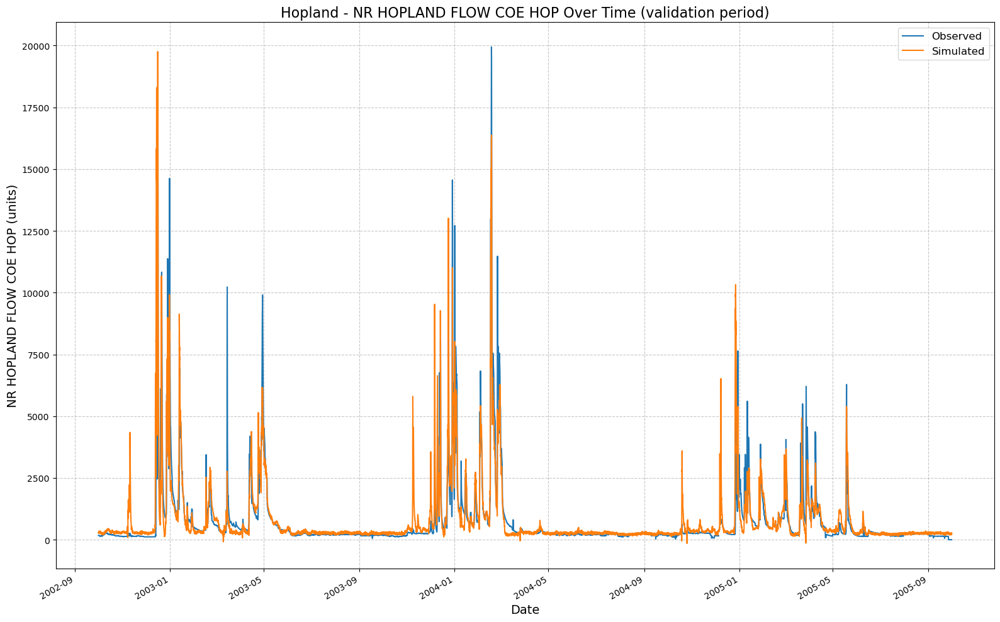

[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\runs\testing_run_1202_120622\results_output_validation.csv


F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


In [10]:
#outputs simple graph, also logs where the csv where the results are stored (use this csv for when you plot combined graph), also prints the metrics
lstmNoPhysicsHourly_results_path_csv, lstmNoPhysicsHourly_results_metrics = lstmNoPhysicsHourly.results() 

## Physics-Informed LSTM (PLSTM) trained on training set, validated on validation set


In [12]:
path_to_physics_data = Path(library_path +"/russian_river_data/Hopland_hourly.csv")
params = {
    "epochs":8,
    "hidden_size": 128,
    "output_dropout": 0.4,
    "seq_length": 90,
}
features_with_physics = [
    #from hourly.csv
    "RUSSIAN 60 ET-POTENTIAL RUN:BASIN AVERAGE 60 YR",
    "RUSSIAN 60 PRECIP-INC SCREENED",
    "RUSSIAN 70 PRECIP-INC SCREENED",
    "RUSSIAN 70 ET-POTENTIAL RUN:BASIN AVERAGE 60 YR",
    "WF RUSSIAN PRECIP-INC SCREENED",
    "WF RUSSIAN ET-POTENTIAL RUN:BASIN AVERAGE 60 YR",
    #from hopland.csv
    'Hopland Gage FLOW',
    'Russian 60 ET-POTENTIAL',
    'Russian 60 FLOW',
    'Russian 60 FLOW-BASE',
    'Russian 60 INFILTRATION',
    'Russian 60 PERC-SOIL',
    'Russian 60 SATURATION FRACTION',
    'Russian 70 ET-POTENTIAL',
    'Russian 70 FLOW',
    'Russian 70 FLOW-BASE',
    'Russian 70 INFILTRATION',
    'Russian 70 PERC-SOIL',
    'Russian 70 SATURATION FRACTION',
    'WF Russian ET-POTENTIAL',
    'WF Russian FLOW',
    'WF Russian FLOW-BASE',
    'WF Russian INFILTRATION',
    'WF Russian PERC-SOIL',
    'WF Russian SATURATION FRACTION',
    "UKIAH CA HUMIDITY USAF-NOAA",
    "UKIAH CA SOLAR RADIATION USAF-NOAA",
    "UKIAH CA TEMPERATURE USAF-NOAA",
    "UKIAH CA WINDSPEED USAF-NOAA",
    "UKIAH CA FLOW USGS-MERGED",
    #"Lake Mendocino Storage",    
    ]
lstmPhysicsHourly = UCB_trainer(path_to_csv, yaml_path= path_to_yaml, hyperparams= params, input_features= features_with_physics, physics_informed=True, physics_data_file=path_to_physics_data, hourly=True)

In [13]:
lstmPhysicsHourly.train()

2025-02-12 12:09:59,731: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\runs\testing_run_1202_120959\output.log initialized.
2025-02-12 12:09:59,734: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\runs\testing_run_1202_120959
2025-02-12 12:09:59,737: ### Run configurations for testing_run
2025-02-12 12:09:59,740: experiment_name: testing_run
2025-02-12 12:09:59,742: train_basin_file: hopland
2025-02-12 12:09:59,744: validation_basin_file: hopland
2025-02-12 12:09:59,746: test_basin_file: hopland
2025-02-12 12:09:59,747: train_start_date: 1994-10-01 00:00:00
2025-02-12 12:09:59,748: train_end_date: 2002-09-30 00:00:00
2025-02-12 12:09:59,749: validation_start_date: 2002-10-01 00:00:00
2025-02-12 12:09:59,752: validation_end_date: 2005-09-30 00:00:00
2025-02-12 12:09:59,754: test_start_date: 2005-10-01 00:00:00
2025-02-12 12:09:59,756: test_end_date: 2009-09-29 00:00:00
2025-02-12 12:09:59,758: device: cpu
2025-02-12 12:09:59,7

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  s

# Validation: 100%|██████████| 1/1 [00:07<00:00,  7.89s/it]
2025-02-12 12:13:51,155: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\runs\testing_run_1202_120959\validation\model_epoch008\validation_metrics.csv
2025-02-12 12:13:51,166: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\runs\testing_run_1202_120959\validation\model_epoch008\validation_results.p


WindowsPath('F:/Dino/UCB-USACE-LSTMs/UCB_training/models/hopland_all/runs/testing_run_1202_120959')

got predictions


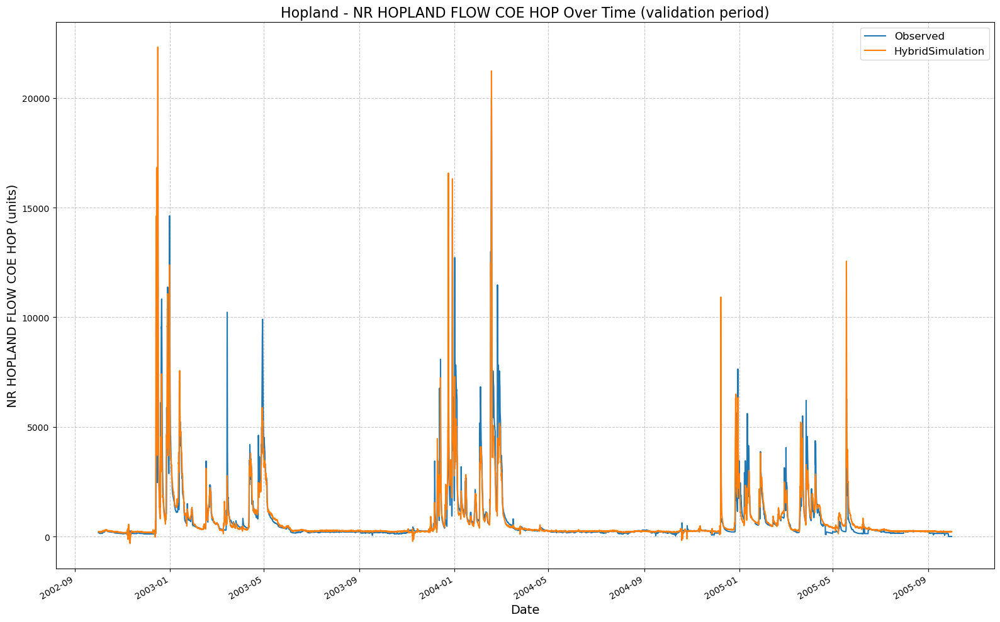

[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\runs\testing_run_1202_120959\results_output_validation.csv


F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


In [14]:
lstmPhysicsHourly_results_path_csv, lstmPhysicsHourly_results_metrics = lstmPhysicsHourly.results()

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\..\..\..\..\UCB-USACE-LSTMs\UCB_training\UCB_utils.py:45: DtypeWarning: Columns (0,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21) have mixed types. Specify dtype option on import or set low_memory=False.
  hms_df = pd.read_csv(HMS_results) #columns: Date, HMS_predicted
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:

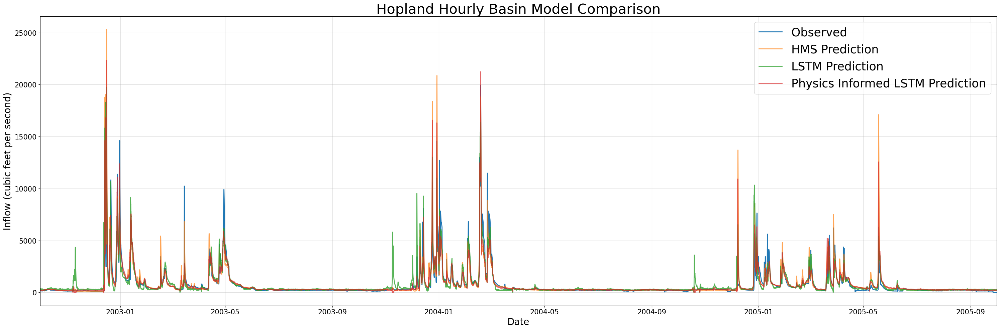

In [15]:
lstm_results_path = 'F:/Dino/UCB-USACE-LSTMs/UCB_training/models/hopland_all/runs/testing_run_0602_205702/results_output_validation.csv'
lstmPhysics_results_path = 'F:/Dino/UCB-USACE-LSTMs/UCB_training/models/hopland_all/runs/testing_run_0602_210204/results_output_validation.csv'
lstm_results_path = lstmNoPhysicsHourly_results_path_csv
lstmPhysics_results_path = lstmPhysicsHourly_results_path_csv
myplot, metrics_df = combinedPlot(lstm_results=lstm_results_path, lstmPhysics_results= lstmPhysics_results_path, HMS_results=path_to_physics_data, title='Hopland Hourly Basin Model Comparison', fName = "hopland_hourly_eval_metrics.csv")

In [16]:
metrics_df

,HMS,LSTM,Physics_Informed_LSTM
NSE,0.758403,0.783619,0.833674
MSE,522557.216143,468017.662702,359752.854213
RMSE,722.881191,684.118164,599.794010
KGE,0.859804,0.869349,0.902878
Alpha-NSE,1.066691,0.957742,0.967090
Beta-KGE,1.054137,1.053098,1.032800
Beta-NSE,0.027782,0.027248,0.016832
Pearson-r,0.889201,0.888356,0.914713
FHV,5.298288,-5.827311,-5.942884
FMS,-8.691652,-12.193288,-6.890500


## If you prefer the interactive plotly graph , you can use 'fancyCombinedPlot' (must have plotly library downloaded)

In [18]:
path_to_physics_data = Path(library_path +"/russian_river_data/Hopland_hourly.csv")

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\..\..\..\..\UCB-USACE-LSTMs\UCB_training\UCB_utils.py:116: DtypeWarning: Columns (0,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21) have mixed types. Specify dtype option on import or set low_memory=False.
  hms_df = pd.read_csv(HMS_results)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is de

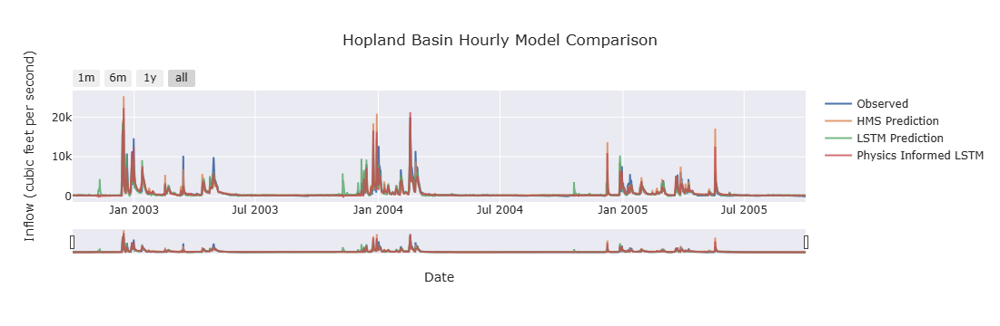

,HMS,LSTM,Physics_Informed_LSTM
NSE,0.758403,0.783619,0.833674
MSE,522557.216143,468017.662702,359752.854213
RMSE,722.881191,684.118164,599.794010
KGE,0.859804,0.869349,0.902878
Alpha-NSE,1.066691,0.957742,0.967090
Beta-KGE,1.054137,1.053098,1.032800
Beta-NSE,0.027782,0.027248,0.016832
Pearson-r,0.889201,0.888356,0.914713
FHV,5.298288,-5.827311,-5.942884
FMS,-8.691652,-12.193288,-6.890500


In [19]:
fancyCombinedPlot(lstm_results=lstm_results_path, lstmPhysics_results= lstmPhysics_results_path, HMS_results=path_to_physics_data, title='Hopland Basin Hourly Model Comparison', fName = "hopland_hourly_eval_metrics.csv")

## Re-train standard hourly LSTM (no ensembles, no physics) on entire dataset, evaluate on test period

In [21]:
params = {
    "epochs":16,
    "hidden_size": 128,
    "output_dropout": 0.4,
    "seq_length": 90,
}
lstmNoPhysicsHourlyExt = UCB_trainer(path_to_csv, yaml_path= path_to_yaml, hyperparams= params, hourly=True, extend_train_period=True)

In [22]:
lstmNoPhysicsHourlyExt.train()

2025-02-12 12:14:01,582: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\runs\testing_run_1202_121401\output.log initialized.
2025-02-12 12:14:01,582: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\runs\testing_run_1202_121401
2025-02-12 12:14:01,582: ### Run configurations for testing_run
2025-02-12 12:14:01,590: experiment_name: testing_run
2025-02-12 12:14:01,590: train_basin_file: hopland
2025-02-12 12:14:01,592: validation_basin_file: hopland
2025-02-12 12:14:01,592: test_basin_file: hopland
2025-02-12 12:14:01,592: train_start_date: 1994-10-01 00:00:00
2025-02-12 12:14:01,592: train_end_date: 2005-09-30 00:00:00
2025-02-12 12:14:01,592: validation_start_date: 2002-10-01 00:00:00
2025-02-12 12:14:01,592: validation_end_date: 2005-09-30 00:00:00
2025-02-12 12:14:01,610: test_start_date: 2005-10-01 00:00:00
2025-02-12 12:14:01,612: test_end_date: 2009-09-29 00:00:00
2025-02-12 12:14:01,612: device: cpu
2025-02-12 12:14:01,6

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.



# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.95s/it]
2025-02-12 12:23:53,969: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\runs\testing_run_1202_121401\validation\model_epoch016\validation_metrics.csv
2025-02-12 12:23:53,971: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\runs\testing_run_1202_121401\validation\model_epoch016\validation_results.p


WindowsPath('F:/Dino/UCB-USACE-LSTMs/UCB_training/models/hopland_all/runs/testing_run_1202_121401')

2025-02-12 12:23:54,042: Using the model weights from F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\runs\testing_run_1202_121401\model_epoch016.pt


F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.



# Evaluation: 100%|██████████| 1/1 [00:06<00:00,  6.64s/it]
2025-02-12 12:24:00,689: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\runs\testing_run_1202_121401\test\model_epoch016\test_metrics.csv
2025-02-12 12:24:00,699: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\runs\testing_run_1202_121401\test\model_epoch016\test_results.p
got predictions


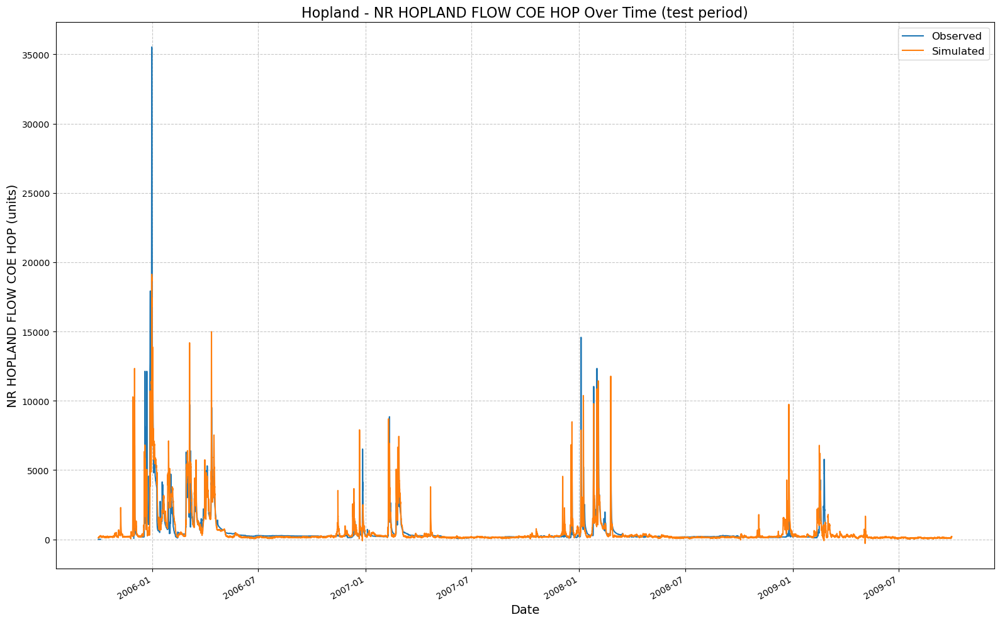

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning:

'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.



[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\runs\testing_run_1202_121401\results_output_test.csv


In [23]:
lstmNoPhysicsHourlyExt_results_path_csv, lstNoPhysicsHourlyExt_results_metrics = lstmNoPhysicsHourlyExt.results('test')

## Re-train physics hourly LSTM (no ensembles, no physics) on entire dataset, evaluate on test period

In [25]:
path_to_physics_data = Path(library_path +"/russian_river_data/Hopland_hourly.csv")
params = {
    "epochs":16,
    "hidden_size": 128,
    "output_dropout": 0.4,
    "seq_length": 90,
}
features_with_physics = [
    #from hourly.csv
    "RUSSIAN 60 ET-POTENTIAL RUN:BASIN AVERAGE 60 YR",
    "RUSSIAN 60 PRECIP-INC SCREENED",
    "RUSSIAN 70 PRECIP-INC SCREENED",
    "RUSSIAN 70 ET-POTENTIAL RUN:BASIN AVERAGE 60 YR",
    "WF RUSSIAN PRECIP-INC SCREENED",
    "WF RUSSIAN ET-POTENTIAL RUN:BASIN AVERAGE 60 YR",
    #from hopland.csv
    'Hopland Gage FLOW',
    'Russian 60 ET-POTENTIAL',
    'Russian 60 FLOW',
    'Russian 60 FLOW-BASE',
    'Russian 60 INFILTRATION',
    'Russian 60 PERC-SOIL',
    'Russian 60 SATURATION FRACTION',
    'Russian 70 ET-POTENTIAL',
    'Russian 70 FLOW',
    'Russian 70 FLOW-BASE',
    'Russian 70 INFILTRATION',
    'Russian 70 PERC-SOIL',
    'Russian 70 SATURATION FRACTION',
    'WF Russian ET-POTENTIAL',
    'WF Russian FLOW',
    'WF Russian FLOW-BASE',
    'WF Russian INFILTRATION',
    'WF Russian PERC-SOIL',
    'WF Russian SATURATION FRACTION',
    "UKIAH CA HUMIDITY USAF-NOAA",
    "UKIAH CA SOLAR RADIATION USAF-NOAA",
    "UKIAH CA TEMPERATURE USAF-NOAA",
    "UKIAH CA WINDSPEED USAF-NOAA",
    "UKIAH CA FLOW USGS-MERGED",
    #"Lake Mendocino Storage",    
    ]
lstmPhysicsHourlyExt = UCB_trainer(path_to_csv, yaml_path= path_to_yaml, hyperparams= params, input_features= features_with_physics, physics_informed=True, physics_data_file=path_to_physics_data, hourly=True, extend_train_period=True)

In [26]:
lstmPhysicsHourlyExt.train()

2025-02-12 12:24:01,827: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\runs\testing_run_1202_122401\output.log initialized.
2025-02-12 12:24:01,827: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\runs\testing_run_1202_122401
2025-02-12 12:24:01,827: ### Run configurations for testing_run
2025-02-12 12:24:01,827: experiment_name: testing_run
2025-02-12 12:24:01,827: train_basin_file: hopland
2025-02-12 12:24:01,827: validation_basin_file: hopland
2025-02-12 12:24:01,827: test_basin_file: hopland
2025-02-12 12:24:01,843: train_start_date: 1994-10-01 00:00:00
2025-02-12 12:24:01,843: train_end_date: 2005-09-30 00:00:00
2025-02-12 12:24:01,843: validation_start_date: 2002-10-01 00:00:00
2025-02-12 12:24:01,843: validation_end_date: 2005-09-30 00:00:00
2025-02-12 12:24:01,843: test_start_date: 2005-10-01 00:00:00
2025-02-12 12:24:01,843: test_end_date: 2009-09-29 00:00:00
2025-02-12 12:24:01,843: device: cpu
2025-02-12 12:24:01,8

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.



# Validation: 100%|██████████| 1/1 [00:08<00:00,  8.06s/it]
2025-02-12 12:34:45,751: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\runs\testing_run_1202_122401\validation\model_epoch016\validation_metrics.csv
2025-02-12 12:34:45,761: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\runs\testing_run_1202_122401\validation\model_epoch016\validation_results.p


WindowsPath('F:/Dino/UCB-USACE-LSTMs/UCB_training/models/hopland_all/runs/testing_run_1202_122401')

2025-02-12 12:34:45,884: Using the model weights from F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\runs\testing_run_1202_122401\model_epoch016.pt


F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.



# Evaluation: 100%|██████████| 1/1 [00:09<00:00,  9.61s/it]
2025-02-12 12:34:55,506: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\runs\testing_run_1202_122401\test\model_epoch016\test_metrics.csv
2025-02-12 12:34:55,516: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\runs\testing_run_1202_122401\test\model_epoch016\test_results.p
got predictions


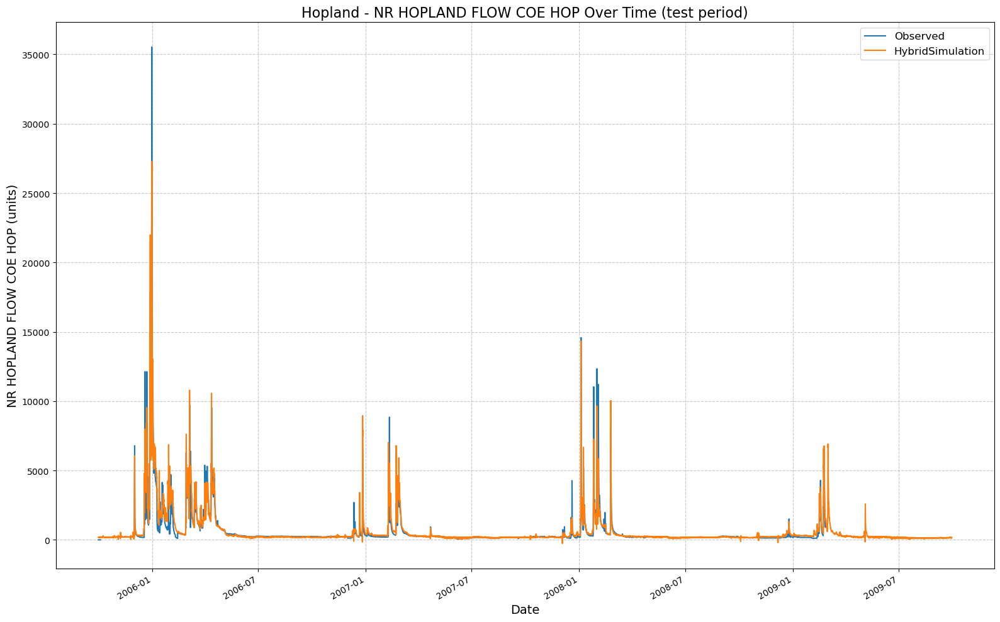

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning:

'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.



[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\runs\testing_run_1202_122401\results_output_test.csv


In [27]:
lstmPhysicsHourlyExt_results_path_csv, lstmPhysicsHourlyExt_results_metrics = lstmPhysicsHourlyExt.results('test')

## compare results

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\..\..\..\..\UCB-USACE-LSTMs\UCB_training\UCB_utils.py:45: DtypeWarning:

Columns (0,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21) have mixed types. Specify dtype option on import or set low_memory=False.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning:

'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all

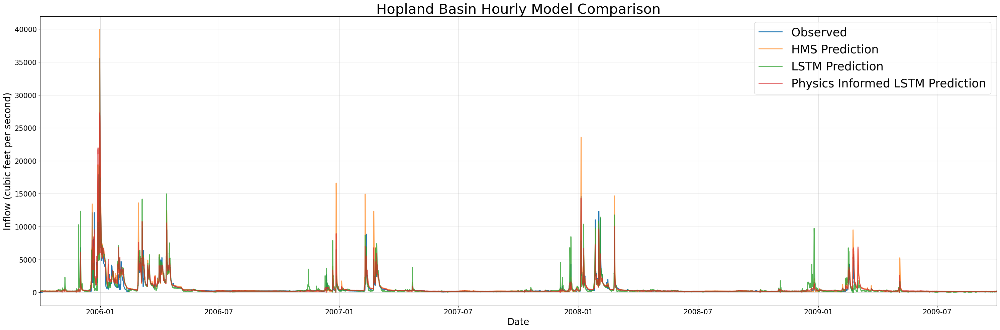

In [29]:
lstm_results_path_ext = lstmNoPhysicsHourlyExt_results_path_csv
lstmPhysics_results_path_ext = lstmPhysicsHourlyExt_results_path_csv
myplot, metrics_df = combinedPlot(lstm_results=lstm_results_path_ext, lstmPhysics_results= lstmPhysics_results_path_ext, HMS_results=path_to_physics_data, title='Hopland Basin Hourly Model Comparison', fName = "hopland_hourly_metrics.csv")

In [30]:
metrics_df

,HMS,LSTM,Physics_Informed_LSTM
NSE,0.751830,0.697186,0.882631
MSE,549210.378443,670140.374018,259742.699901
RMSE,741.087295,818.621020,509.649585
KGE,0.711821,0.802783,0.871776
Alpha-NSE,1.204128,0.896631,1.005247
Beta-KGE,1.185550,1.041522,1.114599
Beta-NSE,0.075689,0.016937,0.046747
Pearson-r,0.916631,0.837256,0.942722
FHV,22.679614,-9.153175,-0.102932
FMS,26.515350,49.701496,28.820755


F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\..\..\..\..\UCB-USACE-LSTMs\UCB_training\UCB_utils.py:116: DtypeWarning:

Columns (0,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21) have mixed types. Specify dtype option on import or set low_memory=False.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning:

'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\hopland_al

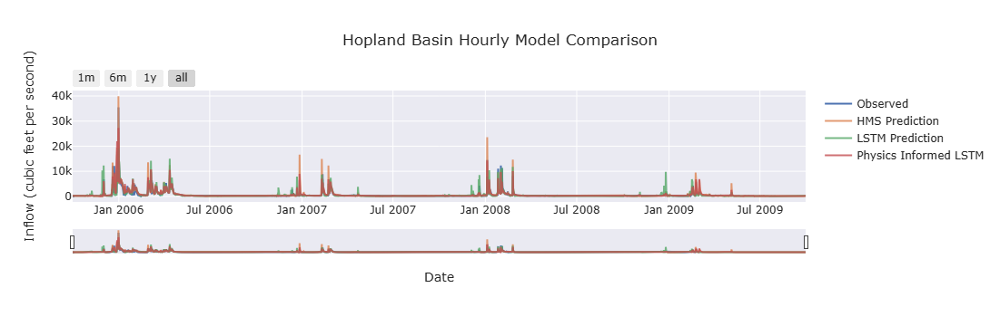

,HMS,LSTM,Physics_Informed_LSTM
NSE,0.751830,0.697186,0.882631
MSE,549210.378443,670140.374018,259742.699901
RMSE,741.087295,818.621020,509.649585
KGE,0.711821,0.802783,0.871776
Alpha-NSE,1.204128,0.896631,1.005247
Beta-KGE,1.185550,1.041522,1.114599
Beta-NSE,0.075689,0.016937,0.046747
Pearson-r,0.916631,0.837256,0.942722
FHV,22.679614,-9.153175,-0.102932
FMS,26.515350,49.701496,28.820755


In [31]:
fancyCombinedPlot(lstm_results=lstm_results_path_ext, lstmPhysics_results= lstmPhysics_results_path_ext, HMS_results=path_to_physics_data, title='Hopland Basin Hourly Model Comparison', fName = "hopland_hourly_metrics.csv")